In [1]:
from matplotlib import pyplot as plt
import rasterio
from rasterio.plot import show as rastershow

import numpy as np
import pandas as pd
import os
import glob

import geojson
import geopandas as gpd
import geoplot
import folium

from shapely.geometry import Point, Polygon

In [2]:
ground_truth_path = '/work/ka1176/shared_data/Deeptree_data_04_Oct_2024/polygon-labelling/tiles/'
labels_path = '/work/ka1176/shared_data/Deeptree_data_04_Oct_2024/polygon-labelling/labels/'
saved_results_dir = '/work/ka1176/shared_data/Deeptree_data_04_Oct_2024/polygon-labelling/data_checking'

##### Plot shape files onto ground truth and display ground truth side by side to see if labelling has been done correctly or not.

##### Results are stored in saved_results_dir

19_17 

BoundingBox(left=705900.0, bottom=5708200.0, right=706000.0, top=5708300.0)
[ 705899.06053541 5708197.91364883  705999.63403152 5708292.4782828 ] 



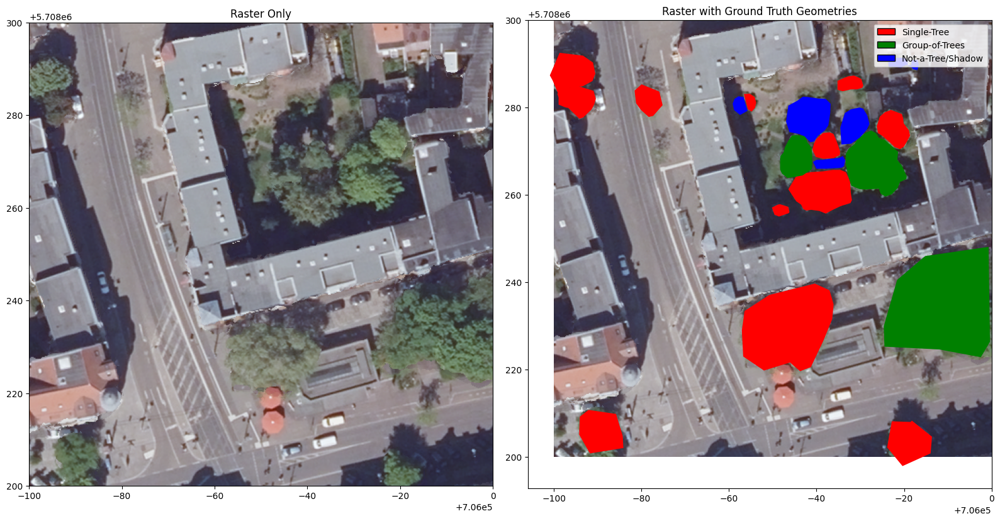

19_18 

BoundingBox(left=705900.0, bottom=5708100.0, right=706000.0, top=5708200.0)
[ 705896.76595256 5708107.54188765  706000.0921955  5708201.84045881] 



/tmp/ipykernel_914209/781183003.py:65: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  class_geometries.plot(ax=ax2, color=color, linewidth=2)


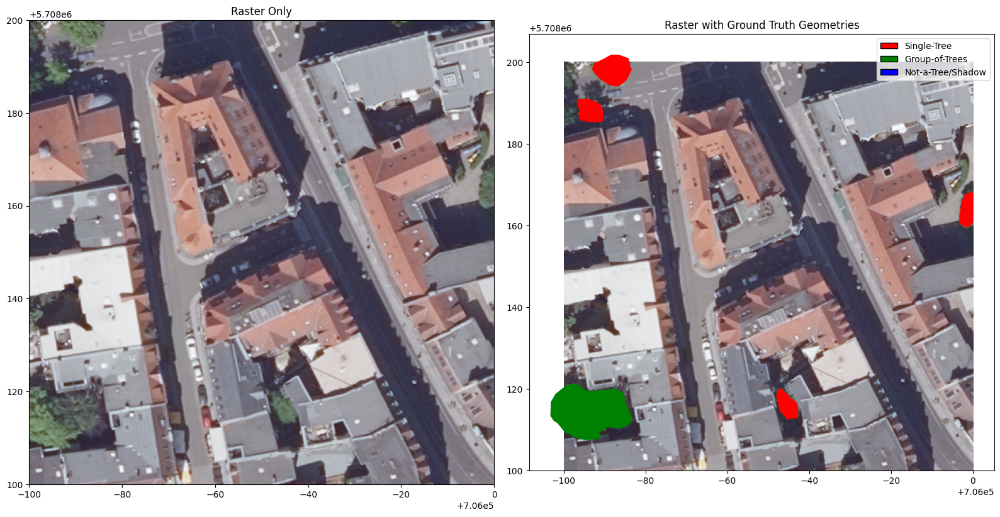

1_1 

BoundingBox(left=704100.0, bottom=5709800.0, right=704200.0, top=5709900.0)
[11.94092091 51.50254119 11.94233242 51.50337907] 

Bounds are not close, reprojection needed.


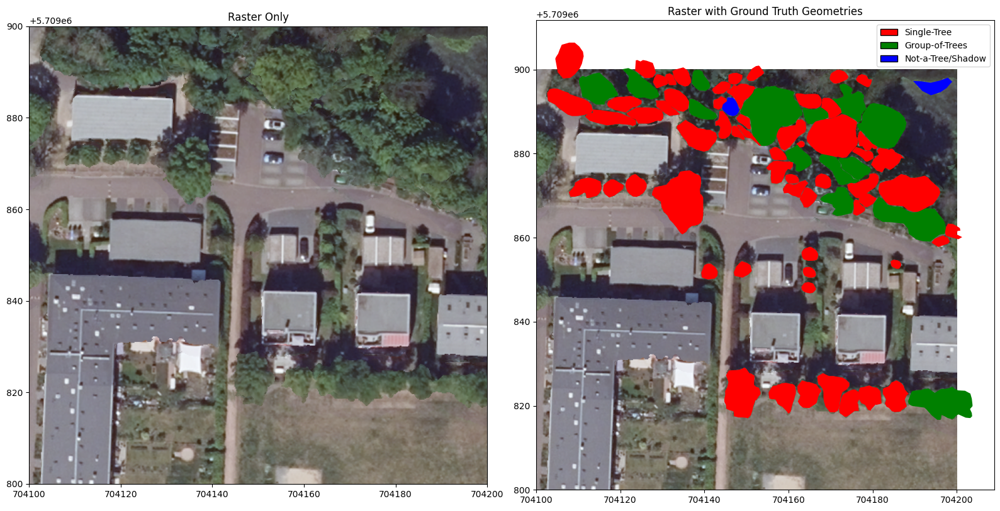

18_17 

BoundingBox(left=705800.0, bottom=5708200.0, right=705900.0, top=5708300.0)
[ 705816.21592447 5708195.81530779  705898.92922223 5708300.22097343] 



/tmp/ipykernel_914209/781183003.py:65: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  class_geometries.plot(ax=ax2, color=color, linewidth=2)


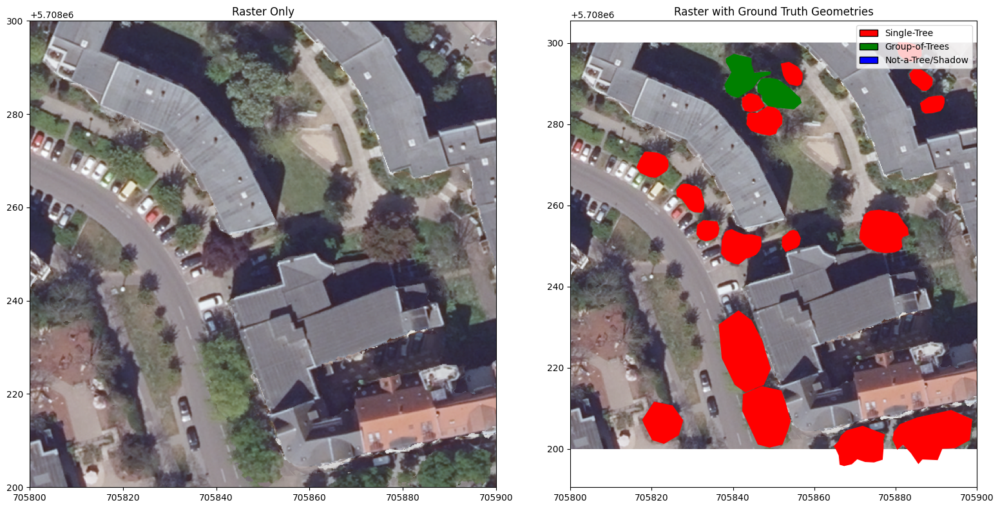

17_19 

BoundingBox(left=705700.0, bottom=5708000.0, right=705800.0, top=5708100.0)
[ 705692.59192909 5707999.51511257  705803.26825771 5708079.57729892] 



/tmp/ipykernel_914209/781183003.py:65: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  class_geometries.plot(ax=ax2, color=color, linewidth=2)


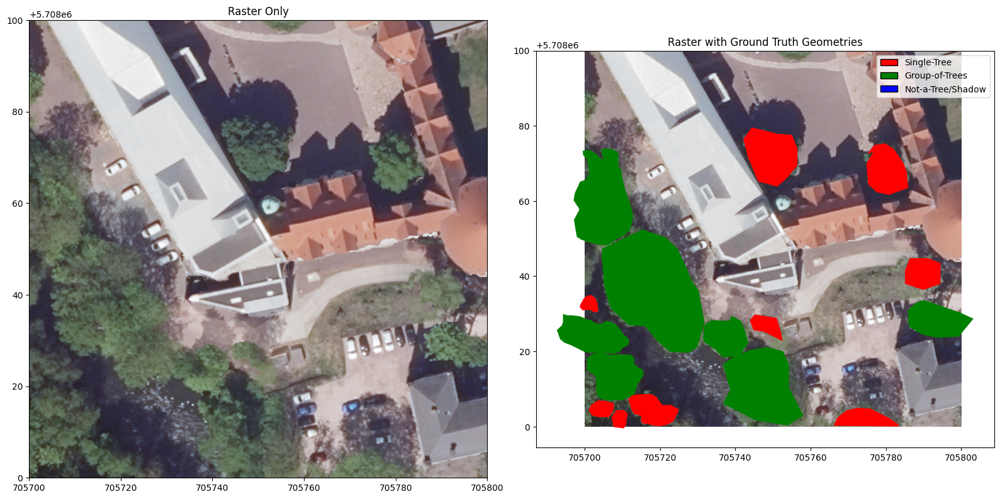

0_1 

BoundingBox(left=704000.0, bottom=5709800.0, right=704100.0, top=5709900.0)
[11.93939573 51.50242271 11.94094801 51.5033714 ] 

Bounds are not close, reprojection needed.


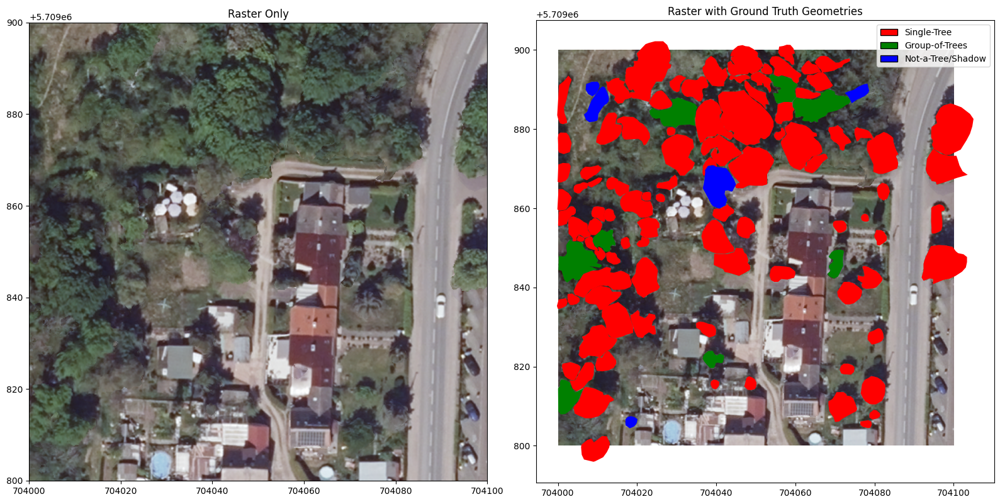

16_19 

BoundingBox(left=705600.0, bottom=5708000.0, right=705700.0, top=5708100.0)
[ 705598.04786004 5708000.11336212  705703.53134935 5708101.21753532] 



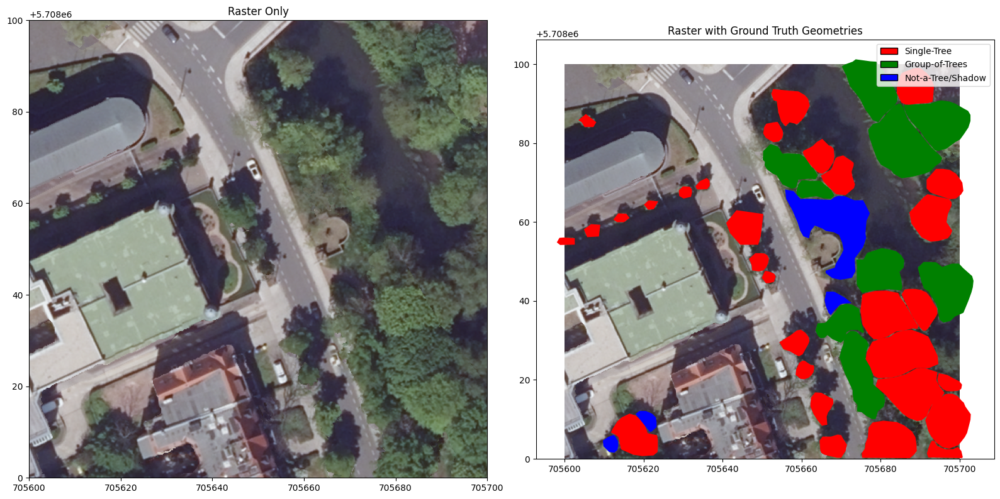

18_19 

BoundingBox(left=705800.0, bottom=5708000.0, right=705900.0, top=5708100.0)
[ 705809.19670005 5708000.15625712  705895.79670846 5708097.65671379] 



/tmp/ipykernel_914209/781183003.py:65: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  class_geometries.plot(ax=ax2, color=color, linewidth=2)
/tmp/ipykernel_914209/781183003.py:65: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  class_geometries.plot(ax=ax2, color=color, linewidth=2)


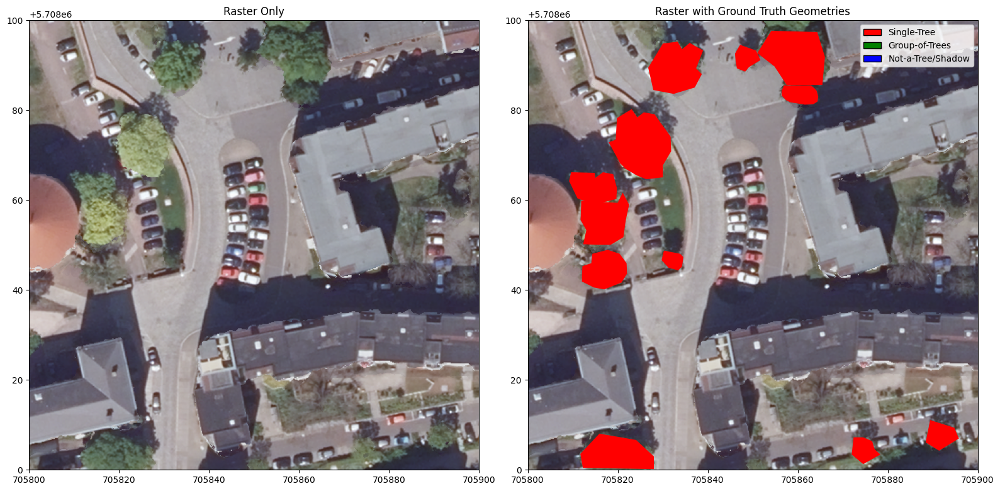

17_18 

BoundingBox(left=705700.0, bottom=5708100.0, right=705800.0, top=5708200.0)
[ 705703.10402825 5708097.87674288  705806.12251966 5708203.17635072] 



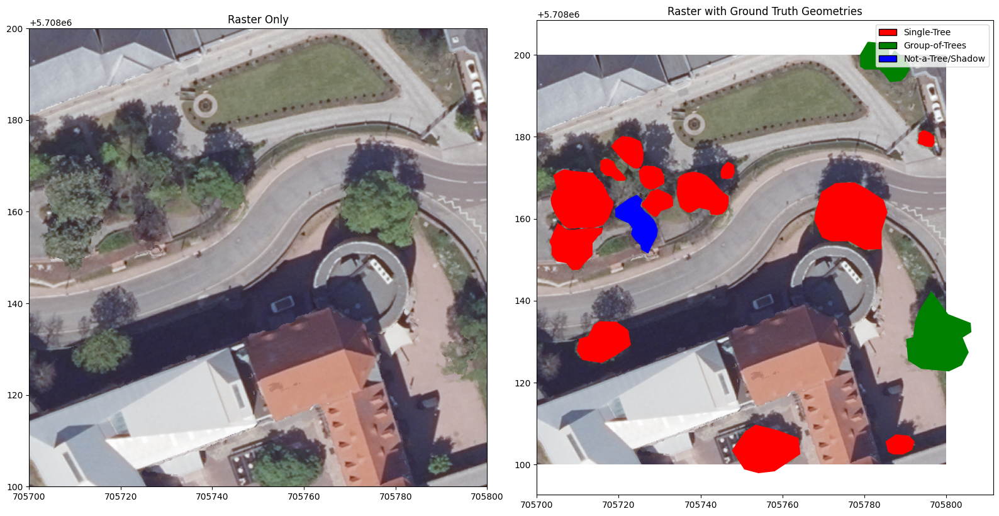

0_0 

BoundingBox(left=704000.0, bottom=5709900.0, right=704100.0, top=5710000.0)
[11.93944957 51.50331057 11.94095756 51.5042416 ] 

Bounds are not close, reprojection needed.


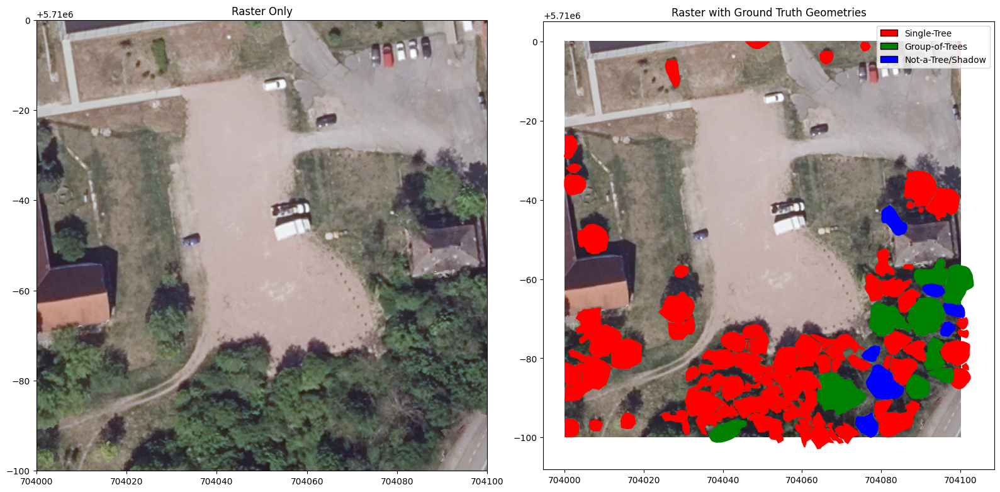

18_18 

BoundingBox(left=705800.0, bottom=5708100.0, right=705900.0, top=5708200.0)
[ 705804.29366567 5708093.54640243  705903.53000232 5708199.96712647] 



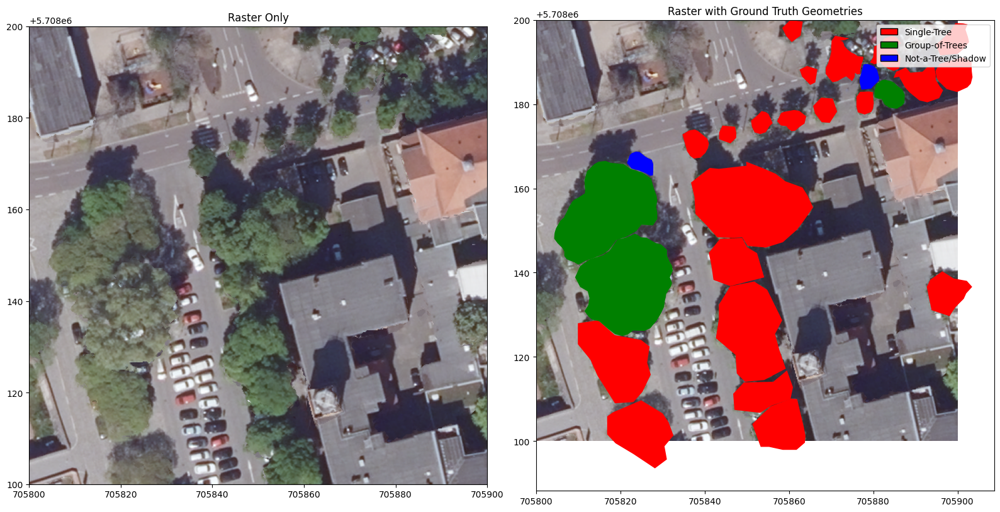

19_19 

BoundingBox(left=705900.0, bottom=5708000.0, right=706000.0, top=5708100.0)
[ 705896.93058746 5708000.00138516  705999.97184133 5708076.67995235] 



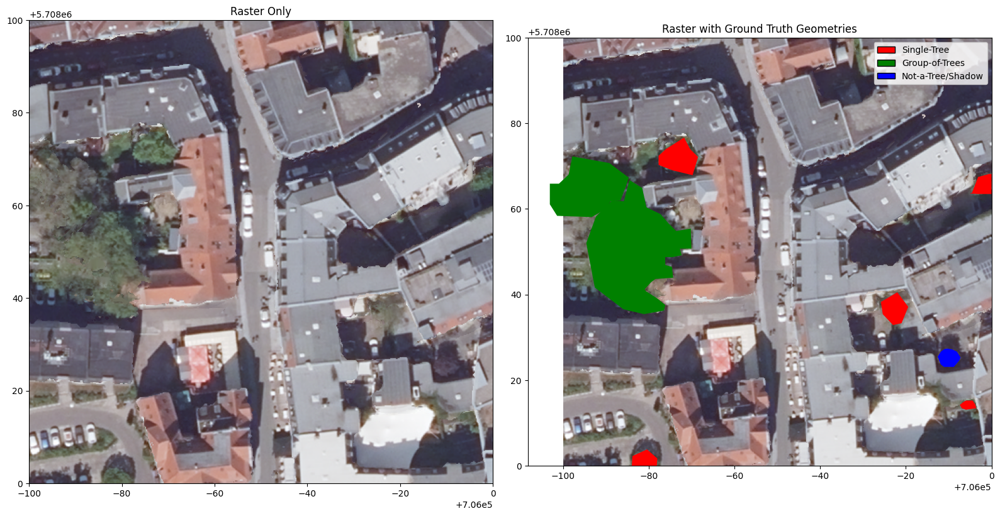

In [8]:
import os
import rasterio
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
from rasterio.plot import show as rastershow
from matplotlib.patches import Patch  # Import to manually create legend entries

# Assuming tif_files and shape_files are already populated as described
for shape_file in shape_files:
    
    shape_file_name  = shape_file.split('label_tile_')[-1].split('.shp')[0]
    print(shape_file_name, '\n')
    
    matching_tif_file = next((tif for tif in tif_files if tif.split('.tif')[0].split('tile_')[-1] == shape_file_name), None)

    tif_file = matching_tif_file
    data_root = '/work/ka1176/shared_data/Deeptree_data_04_Oct_2024/polygon-labelling/'
    rastertif = rasterio.open(os.path.join(data_root, 'tiles', tif_file))
    arr = rastertif.read()

    ground_truth = gpd.read_file(os.path.join(data_root, 'labels', shape_file))

    # Get raster bounds
    raster_bounds = rastertif.bounds
    print(raster_bounds)

    # Get bounds of the ground truth geometries
    geometry_bounds = ground_truth.total_bounds
    print(geometry_bounds, '\n')

    # Set a tolerance for floating-point comparison (adjust if necessary)
    tolerance = 1e2

    # Check if the bounds are approximately the same (within the tolerance)
    bounds_are_close = np.allclose(
        [raster_bounds.left, raster_bounds.bottom, raster_bounds.right, raster_bounds.top],
        geometry_bounds,
        atol=tolerance
    )

    # If the bounds are not almost the same, reproject the ground truth geometries
    if not bounds_are_close:
        print("Bounds are not close, reprojection needed.")
        ground_truth = ground_truth.set_crs("EPSG:4326", allow_override=True)
        ground_truth = ground_truth.to_crs("EPSG:25832")

    # Step 3: Create two subplots side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

    # Plot the raster on the first subplot
    rastershow(rastertif, ax=ax1)
    ax1.set_title("Raster Only")

    # Plot the raster with ground truth geometries on the second subplot
    rastershow(rastertif, ax=ax2)

    # Define the color and label mappings
    class_to_color = {0: 'red', 1: 'green', 2: 'blue'}
    class_to_label = {0: 'Single-Tree', 1: 'Group-of-Trees', 2: 'Not-a-Tree/Shadow'}

    # Plot each class with its corresponding color and label
    for class_value, color in class_to_color.items():
        class_geometries = ground_truth[ground_truth['class'] == class_value]
        class_geometries.plot(ax=ax2, color=color, linewidth=2)
    
    ax2.set_title("Raster with Ground Truth Geometries")

    # Manually create the legend
    legend_elements = [Patch(facecolor=color, edgecolor='k', label=class_to_label[class_value]) 
                       for class_value, color in class_to_color.items()]
    
    # Add the legend to the second axis
    ax2.legend(handles=legend_elements, loc='upper right')  # Adjust location if needed

    # Adjust layout for better appearance
    plt.tight_layout()

    # Save the figure
    plt.savefig(f'{saved_results_dir}/tile_{shape_file_name}.png')
    plt.show()    
